In [ ]:
import os
from google.colab import files

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import os
import gdown
from zipfile import ZipFile

files.upload()
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d gpiosenka/butterfly-images40-species

Saving kaggle.json to kaggle.json
Dataset URL: https://www.kaggle.com/datasets/gpiosenka/butterfly-images40-species
License(s): CC0-1.0
 96% 385M/399M [00:04<00:00, 104MB/s] 
100% 399M/399M [00:04<00:00, 96.1MB/s]


In [ ]:
with ZipFile("butterfly-images40-species.zip", "r") as zipobj:
    zipobj.extractall("butterfly")

In [ ]:
dataset = keras.utils.image_dataset_from_directory(
    "butterfly", label_mode=None, image_size=(64, 64), batch_size=32
)
dataset = dataset.map(lambda x: (x - 127.5) / 127.5)

Found 13594 files belonging to 1 classes.


In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import cv2
import glob
import PIL
from tensorflow.keras import layers
import time
from IPython import display

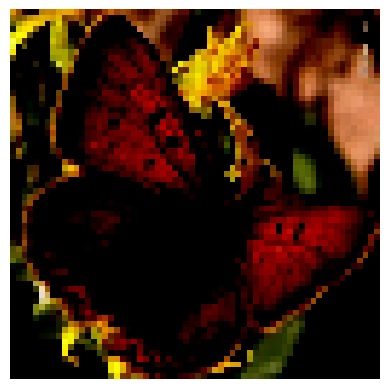

In [ ]:
for x in dataset:
    plt.axis("off")
    plt.imshow((x.numpy() * 255).astype("int32")[0])
    break

In [ ]:
def build_discriminator(width, height, depth, alpha=0.2):
    model = tf.keras.Sequential(name='discriminator1')
    input_shape = (height, width, depth)

    # first set of CONV => BN => leaky ReLU layers
    model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding="same", input_shape=input_shape))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=alpha))

    # second set of CONV => BN => leacy ReLU layers
    model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding="same"))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=alpha))

    # third set of CONV => BN => leacy ReLU layers
    model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding="same"))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=alpha))

    model.add(layers.Flatten())
    model.add(layers.Dropout(0.3))

    model.add(layers.Dense(1, activation="sigmoid"))

    return model


discriminator = build_discriminator(64,64,3)
discriminator.summary()

Model: "discriminator1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (Batch  (None, 32, 32, 64)        256       
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Bat  (None, 16, 16, 128)       512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)    

In [ ]:
CHANNELS = 3 # red, green, and blue
LATENT_DIM = 100 # latent dimension of the random noise
WEIGHT_INIT = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
def build_generator():

    model = tf.keras.Sequential(name='generator1')

    model.add(layers.Dense(8*8*512, input_dim=LATENT_DIM))
    #model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    model.add(layers.Reshape((8,8,512)))

    # upsample to 16x16: apply a transposed CONV => BN => RELU
    model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2),padding="same", kernel_initializer=WEIGHT_INIT))
    #model.add(layers.BatchNormalization())
    model.add((layers.ReLU()))

    # upsample to 32x32: apply a transposed CONV => BN => RELU
    model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2),padding="same", kernel_initializer=WEIGHT_INIT))
    #model.add(layers.BatchNormalization())
    model.add((layers.ReLU()))

    # upsample to 64x64: apply a transposed CONV => BN => RELU
    model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2),padding="same", kernel_initializer=WEIGHT_INIT))
    #model.add(layers.BatchNormalization())
    model.add((layers.ReLU()))

    model.add(layers.Conv2D(CHANNELS, (4, 4), padding="same", activation="tanh"))

    return model

generator = build_generator()
generator.summary()

Model: "generator1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_1 (Dense)             (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 16, 16, 256)       2097408   
 anspose)                                                        
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 32, 32, 128)       524416    
 Transpose)                                             

/usr/local/lib/python3.10/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


In [ ]:
class DCGAN(tf.keras.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super().__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_loss_metric = tf.keras.metrics.Mean(name="d_loss")
        self.g_loss_metric = tf.keras.metrics.Mean(name="g_loss")

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn

    @property
    def metrics(self):
        return [self.d_loss_metric, self.g_loss_metric]

    def train_step(self, real_images):

        batch_size = tf.shape(real_images)[0]
        noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # Step 1. Train the discriminator with both real images (label as 1) and fake images (classified as label as 0)
        with tf.GradientTape() as tape:
            # Compute discriminator loss on real images
            pred_real = self.discriminator(real_images, training=True)
            real_labels = tf.ones((batch_size, 1))
            # UPDATED: apply one-sided label smoothing to real labels
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # Compute discriminator loss on fake images
            fake_images = self.generator(noise)
            pred_fake = self.discriminator(fake_images, training=True)
            fake_labels = tf.zeros((batch_size, 1))
            # UPDATED: add random noise to fake labels - not needed
            # fake_labels += 0.05 * tf.random.uniform(tf.shape(fake_labels))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake)/2
        # Compute discriminator gradients
        grads = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # Update discriminator weights
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_variables))

        # Step 2. Train the generator (do not update weights of the discriminator)
        misleading_labels = tf.ones((batch_size, 1)) # G wants D to think the fake images are real (label as 1)

        with tf.GradientTape() as tape:
            fake_images = self.generator(noise, training=True)
            pred_fake = self.discriminator(fake_images, training=True)
            g_loss = self.loss_fn(misleading_labels, pred_fake)
        # Compute generator gradients
        grads = tape.gradient(g_loss, self.generator.trainable_variables)
        # Update generator wieghts
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_variables))

        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {"d_loss": self.d_loss_metric.result(), "g_loss": self.g_loss_metric.result()}


In [ ]:
class GANMonitor(tf.keras.callbacks.Callback):
    def __init__(self, num_img=3, latent_dim=100):
        self.num_img = num_img
        self.latent_dim = latent_dim

        # Create random noise seed for visualization during traing
        self.seed = tf.random.normal([16, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        generated_images = self.model.generator(self.seed)
        generated_images = (generated_images * 127.5) + 127.5
        generated_images.numpy()

        fig = plt.figure(figsize=(4, 4))
        for i in range(self.num_img):
            plt.subplot(4, 4, i+1)
            img = tf.keras.utils.array_to_img(generated_images[i])
            plt.imshow(img)
            plt.axis('off')
        plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

Epoch 1/120
425/425 [==============================] - ETA: 0s - d_loss: 1.6771 - g_loss: 1.1999

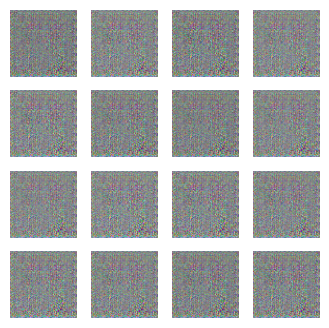

425/425 [==============================] - 42s 72ms/step - d_loss: 1.6771 - g_loss: 1.1999
Epoch 2/120
425/425 [==============================] - ETA: 0s - d_loss: 0.0672 - g_loss: 3.0923

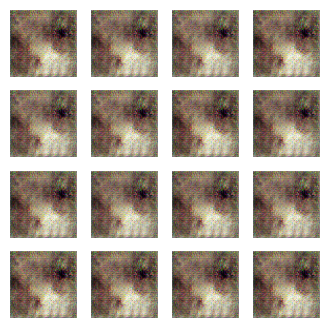

425/425 [==============================] - 31s 71ms/step - d_loss: 0.0672 - g_loss: 3.0923
Epoch 3/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6604 - g_loss: 1.3488

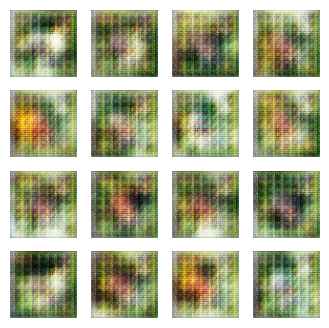

425/425 [==============================] - 30s 70ms/step - d_loss: 0.6604 - g_loss: 1.3488
Epoch 4/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6290 - g_loss: 1.0830

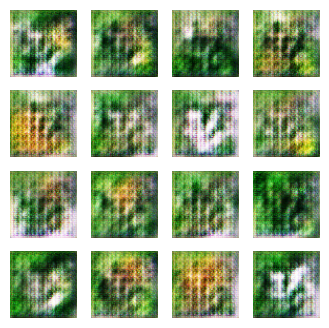

425/425 [==============================] - 30s 69ms/step - d_loss: 0.6290 - g_loss: 1.0830
Epoch 5/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5681 - g_loss: 1.2792

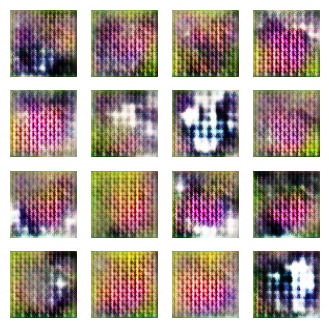

425/425 [==============================] - 30s 71ms/step - d_loss: 0.5681 - g_loss: 1.2792
Epoch 6/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6257 - g_loss: 1.2367

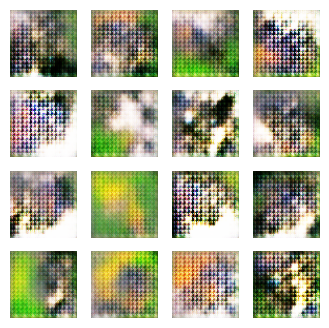

425/425 [==============================] - 30s 70ms/step - d_loss: 0.6257 - g_loss: 1.2367
Epoch 7/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6463 - g_loss: 1.1836

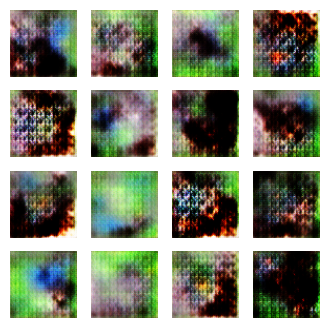

425/425 [==============================] - 30s 70ms/step - d_loss: 0.6463 - g_loss: 1.1836
Epoch 8/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5958 - g_loss: 1.3181

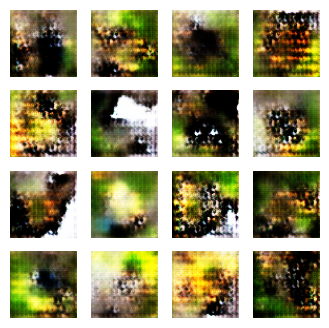

425/425 [==============================] - 30s 70ms/step - d_loss: 0.5958 - g_loss: 1.3181
Epoch 9/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6444 - g_loss: 1.2614

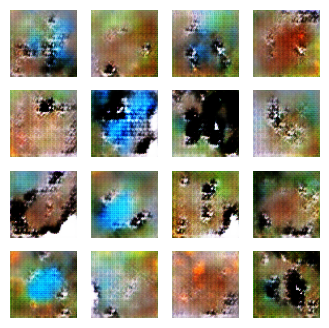

425/425 [==============================] - 30s 71ms/step - d_loss: 0.6444 - g_loss: 1.2614
Epoch 10/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6839 - g_loss: 1.1398

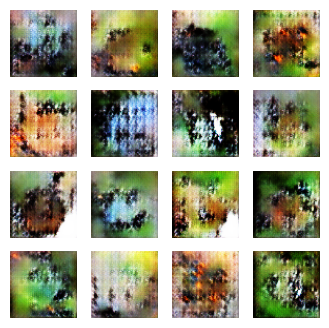

425/425 [==============================] - 30s 71ms/step - d_loss: 0.6839 - g_loss: 1.1398
Epoch 11/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6691 - g_loss: 1.0908

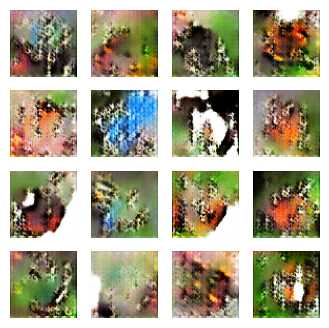

425/425 [==============================] - 30s 70ms/step - d_loss: 0.6691 - g_loss: 1.0908
Epoch 12/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6182 - g_loss: 1.1636

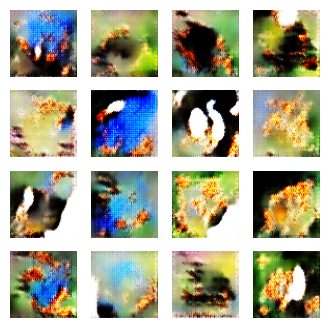

425/425 [==============================] - 30s 71ms/step - d_loss: 0.6182 - g_loss: 1.1636
Epoch 13/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5897 - g_loss: 1.2972

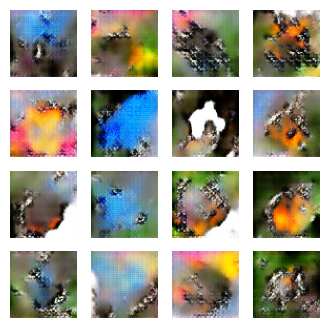

425/425 [==============================] - 31s 72ms/step - d_loss: 0.5897 - g_loss: 1.2972
Epoch 14/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5722 - g_loss: 1.2517

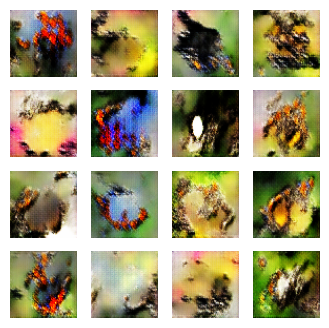

425/425 [==============================] - 30s 71ms/step - d_loss: 0.5722 - g_loss: 1.2517
Epoch 15/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5891 - g_loss: 1.2239

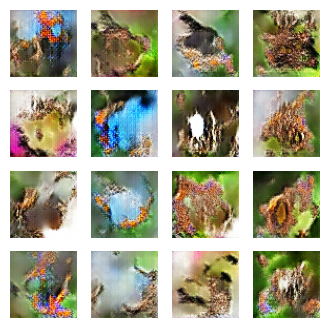

425/425 [==============================] - 31s 72ms/step - d_loss: 0.5891 - g_loss: 1.2239
Epoch 16/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6293 - g_loss: 1.1076

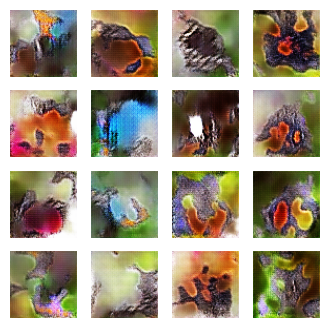

425/425 [==============================] - 31s 72ms/step - d_loss: 0.6293 - g_loss: 1.1076
Epoch 17/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6540 - g_loss: 1.0366

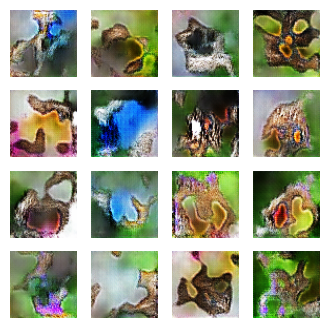

425/425 [==============================] - 31s 74ms/step - d_loss: 0.6540 - g_loss: 1.0366
Epoch 18/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6525 - g_loss: 1.0003

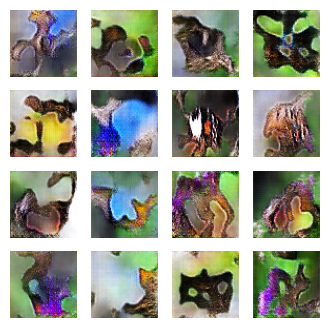

425/425 [==============================] - 31s 73ms/step - d_loss: 0.6525 - g_loss: 1.0003
Epoch 19/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6379 - g_loss: 1.0156

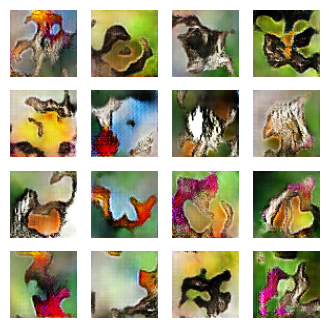

425/425 [==============================] - 31s 73ms/step - d_loss: 0.6379 - g_loss: 1.0156
Epoch 20/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6387 - g_loss: 1.0336

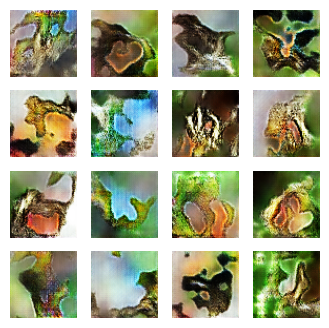

425/425 [==============================] - 31s 74ms/step - d_loss: 0.6387 - g_loss: 1.0336
Epoch 21/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6280 - g_loss: 1.0387

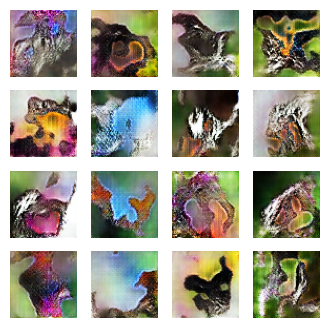

425/425 [==============================] - 32s 74ms/step - d_loss: 0.6280 - g_loss: 1.0387
Epoch 22/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6146 - g_loss: 1.0402

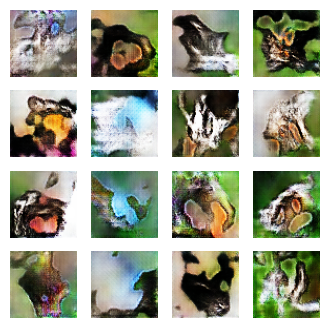

425/425 [==============================] - 32s 75ms/step - d_loss: 0.6146 - g_loss: 1.0402
Epoch 23/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6142 - g_loss: 1.0625

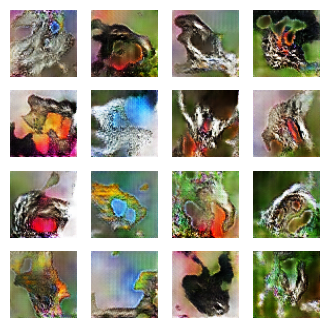

425/425 [==============================] - 32s 74ms/step - d_loss: 0.6142 - g_loss: 1.0625
Epoch 24/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6122 - g_loss: 1.0753

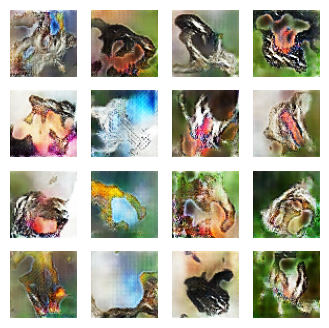

425/425 [==============================] - 32s 74ms/step - d_loss: 0.6122 - g_loss: 1.0753
Epoch 25/120
425/425 [==============================] - ETA: 0s - d_loss: 0.6071 - g_loss: 1.0671

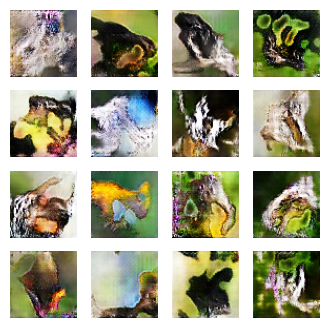

425/425 [==============================] - 31s 74ms/step - d_loss: 0.6071 - g_loss: 1.0671
Epoch 26/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5987 - g_loss: 1.0763

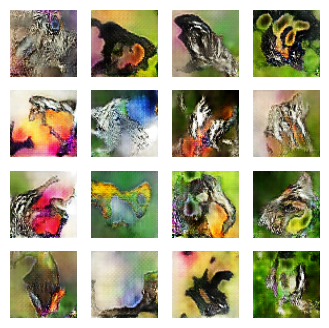

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5987 - g_loss: 1.0763
Epoch 27/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5986 - g_loss: 1.0892

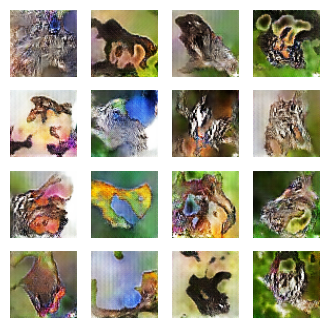

425/425 [==============================] - 32s 75ms/step - d_loss: 0.5986 - g_loss: 1.0892
Epoch 28/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5950 - g_loss: 1.1031

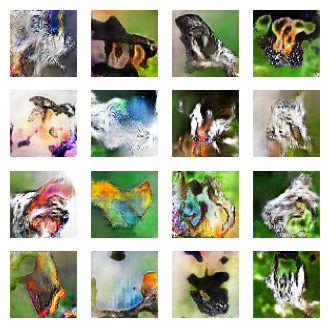

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5950 - g_loss: 1.1031
Epoch 29/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5953 - g_loss: 1.1039

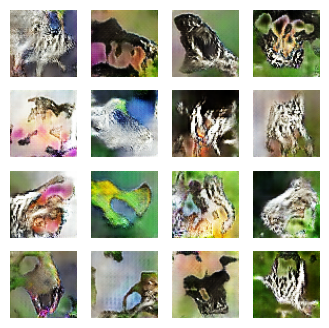

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5953 - g_loss: 1.1039
Epoch 30/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5909 - g_loss: 1.1159

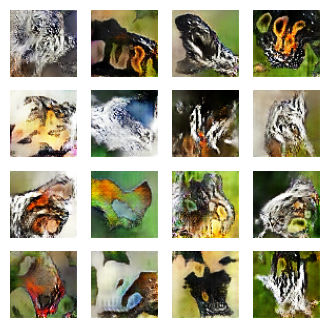

425/425 [==============================] - 31s 73ms/step - d_loss: 0.5909 - g_loss: 1.1159
Epoch 31/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5887 - g_loss: 1.1220

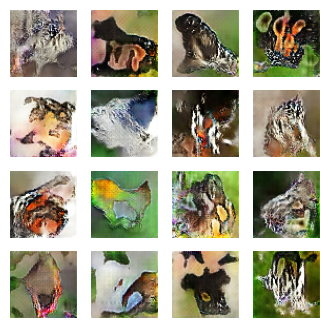

425/425 [==============================] - 33s 76ms/step - d_loss: 0.5887 - g_loss: 1.1220
Epoch 32/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5849 - g_loss: 1.1325

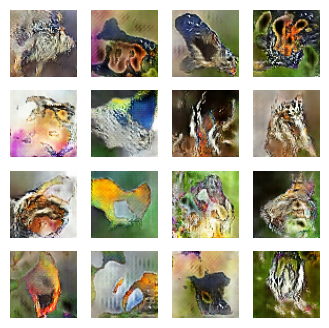

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5849 - g_loss: 1.1325
Epoch 33/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5749 - g_loss: 1.1370

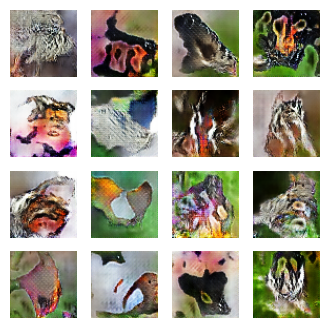

425/425 [==============================] - 32s 75ms/step - d_loss: 0.5749 - g_loss: 1.1370
Epoch 34/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5717 - g_loss: 1.1518

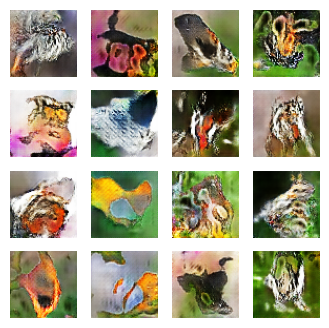

425/425 [==============================] - 32s 75ms/step - d_loss: 0.5717 - g_loss: 1.1518
Epoch 35/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5674 - g_loss: 1.1665

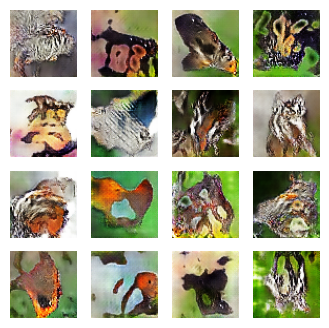

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5674 - g_loss: 1.1665
Epoch 36/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5668 - g_loss: 1.1887

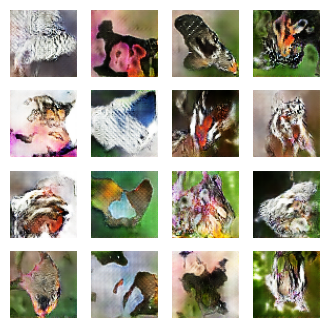

425/425 [==============================] - 32s 76ms/step - d_loss: 0.5668 - g_loss: 1.1887
Epoch 37/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5596 - g_loss: 1.2121

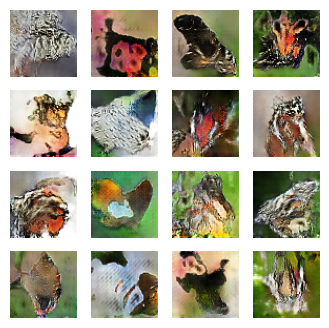

425/425 [==============================] - 32s 75ms/step - d_loss: 0.5596 - g_loss: 1.2121
Epoch 38/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5545 - g_loss: 1.2207

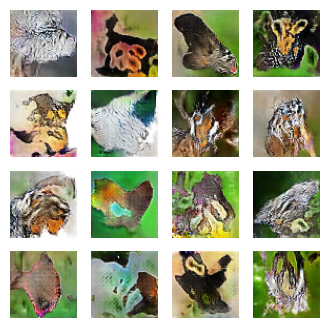

425/425 [==============================] - 32s 75ms/step - d_loss: 0.5545 - g_loss: 1.2207
Epoch 39/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5476 - g_loss: 1.2294

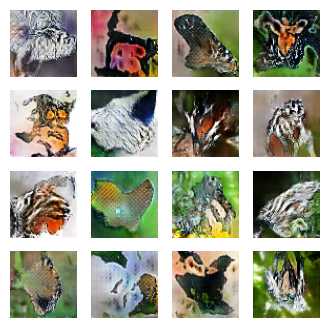

425/425 [==============================] - 32s 75ms/step - d_loss: 0.5476 - g_loss: 1.2294
Epoch 40/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5438 - g_loss: 1.2726

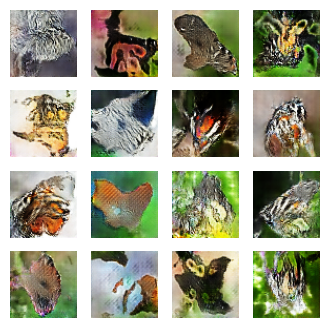

425/425 [==============================] - 32s 75ms/step - d_loss: 0.5438 - g_loss: 1.2726
Epoch 41/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5408 - g_loss: 1.2713

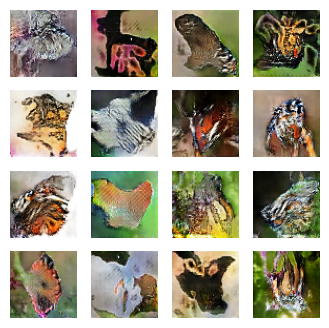

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5408 - g_loss: 1.2713
Epoch 42/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5402 - g_loss: 1.2768

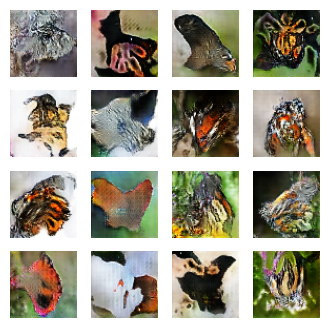

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5402 - g_loss: 1.2768
Epoch 43/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5282 - g_loss: 1.3054

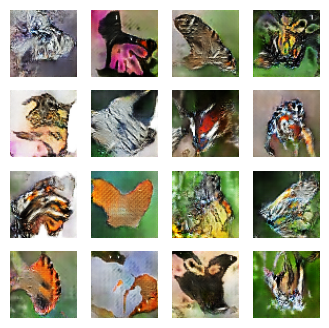

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5282 - g_loss: 1.3054
Epoch 44/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5241 - g_loss: 1.3346

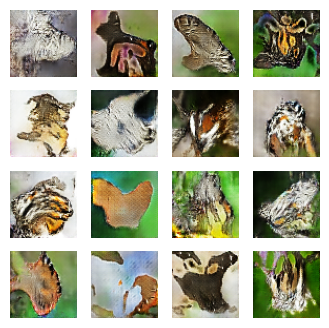

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5241 - g_loss: 1.3346
Epoch 45/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5238 - g_loss: 1.3488

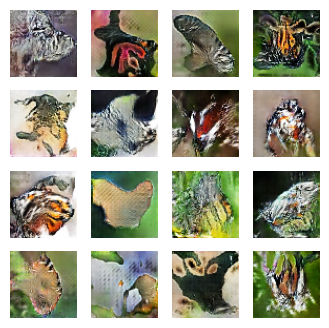

425/425 [==============================] - 32s 75ms/step - d_loss: 0.5238 - g_loss: 1.3488
Epoch 46/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5233 - g_loss: 1.3607

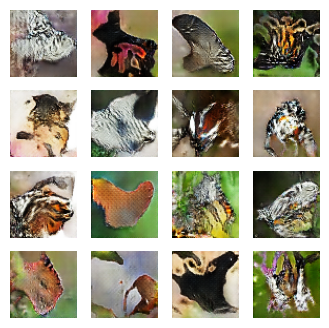

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5233 - g_loss: 1.3607
Epoch 47/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5142 - g_loss: 1.3670

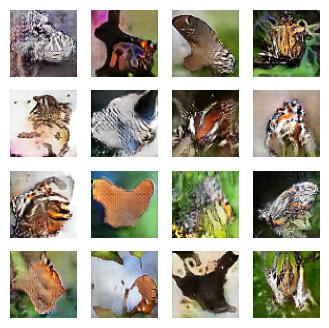

425/425 [==============================] - 31s 73ms/step - d_loss: 0.5142 - g_loss: 1.3670
Epoch 48/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5101 - g_loss: 1.3889

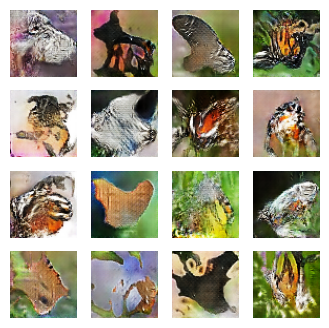

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5101 - g_loss: 1.3889
Epoch 49/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5130 - g_loss: 1.3924

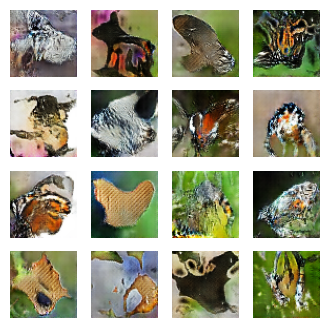

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5130 - g_loss: 1.3924
Epoch 50/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5111 - g_loss: 1.4090

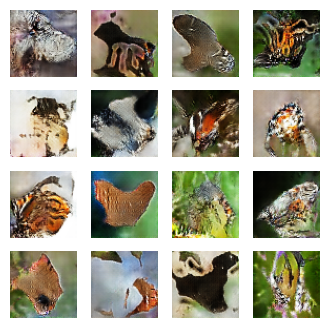

425/425 [==============================] - 32s 74ms/step - d_loss: 0.5111 - g_loss: 1.4090
Epoch 51/120
425/425 [==============================] - ETA: 0s - d_loss: 0.5015 - g_loss: 1.4168

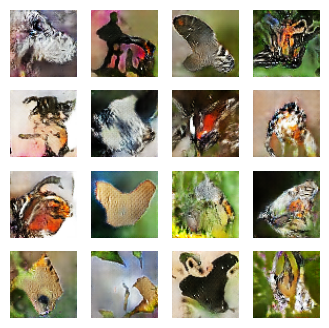

425/425 [==============================] - 32s 75ms/step - d_loss: 0.5015 - g_loss: 1.4168
Epoch 52/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4962 - g_loss: 1.4419

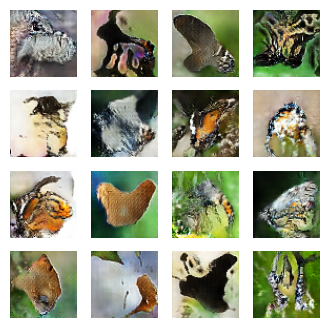

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4962 - g_loss: 1.4419
Epoch 53/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4905 - g_loss: 1.4699

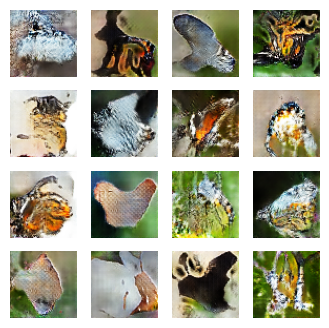

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4905 - g_loss: 1.4699
Epoch 54/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4960 - g_loss: 1.4739

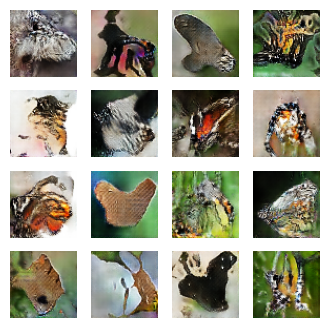

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4960 - g_loss: 1.4739
Epoch 55/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4899 - g_loss: 1.4695

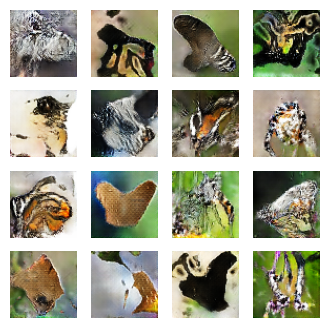

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4899 - g_loss: 1.4695
Epoch 56/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4845 - g_loss: 1.4878

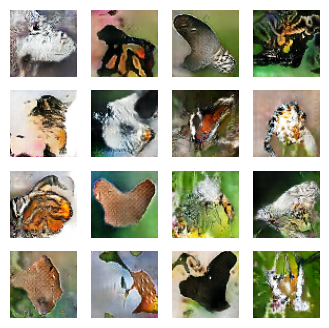

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4845 - g_loss: 1.4878
Epoch 57/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4924 - g_loss: 1.5244

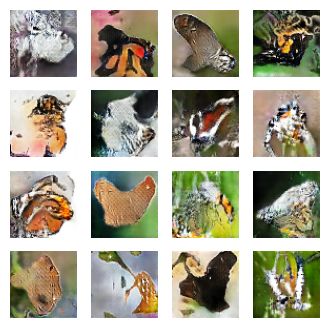

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4924 - g_loss: 1.5244
Epoch 58/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4797 - g_loss: 1.5206

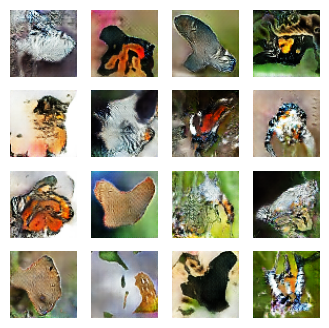

425/425 [==============================] - 32s 76ms/step - d_loss: 0.4797 - g_loss: 1.5206
Epoch 59/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4847 - g_loss: 1.5283

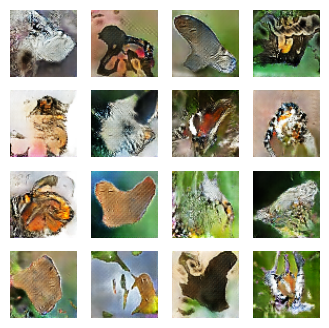

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4847 - g_loss: 1.5283
Epoch 60/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4754 - g_loss: 1.5648

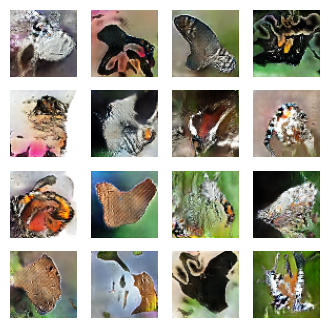

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4754 - g_loss: 1.5648
Epoch 61/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4797 - g_loss: 1.5751

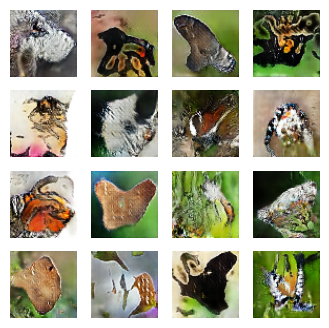

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4797 - g_loss: 1.5751
Epoch 62/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4708 - g_loss: 1.5667

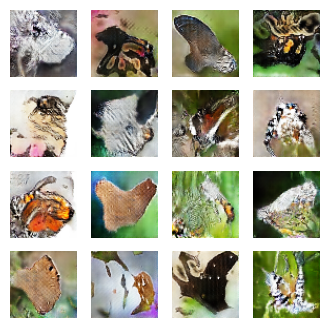

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4708 - g_loss: 1.5667
Epoch 63/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4709 - g_loss: 1.6013

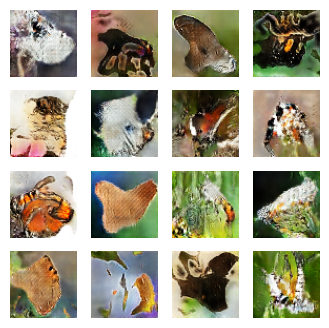

425/425 [==============================] - 32s 76ms/step - d_loss: 0.4709 - g_loss: 1.6013
Epoch 64/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4648 - g_loss: 1.6084

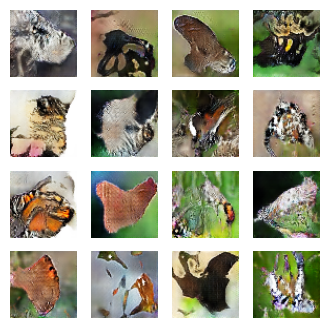

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4648 - g_loss: 1.6084
Epoch 65/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4544 - g_loss: 1.6463

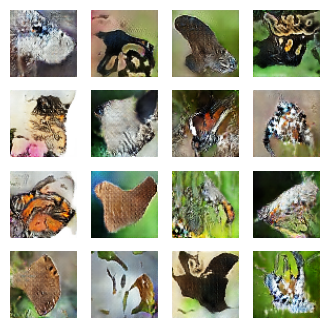

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4544 - g_loss: 1.6463
Epoch 66/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4648 - g_loss: 1.6251

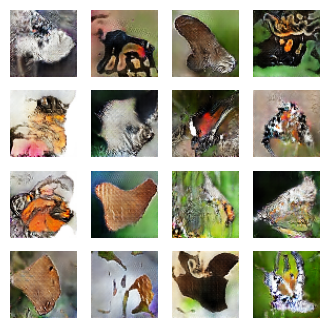

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4648 - g_loss: 1.6251
Epoch 67/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4598 - g_loss: 1.6484

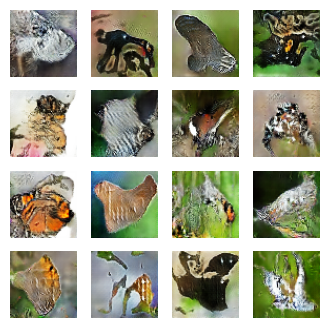

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4598 - g_loss: 1.6484
Epoch 68/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4538 - g_loss: 1.6560

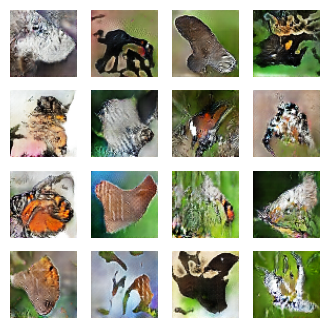

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4538 - g_loss: 1.6560
Epoch 69/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4509 - g_loss: 1.6981

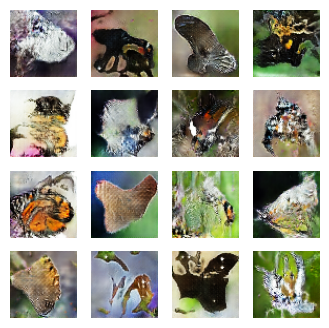

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4509 - g_loss: 1.6981
Epoch 70/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4583 - g_loss: 1.6996

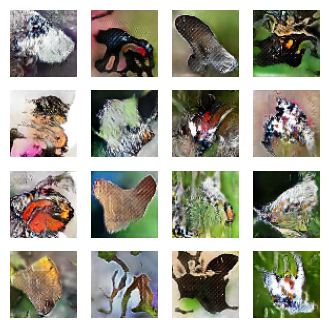

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4583 - g_loss: 1.6996
Epoch 71/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4487 - g_loss: 1.7097

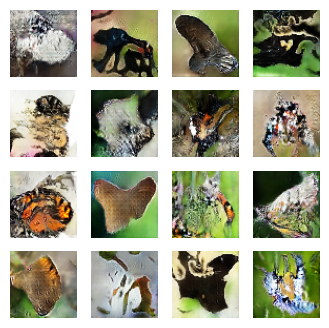

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4487 - g_loss: 1.7097
Epoch 72/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4456 - g_loss: 1.7082

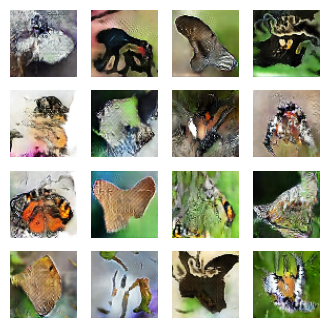

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4456 - g_loss: 1.7082
Epoch 73/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4457 - g_loss: 1.7536

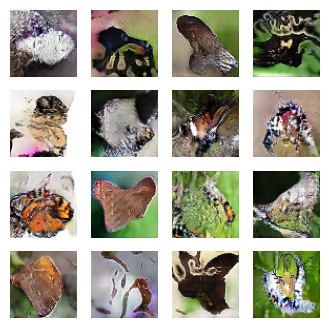

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4457 - g_loss: 1.7536
Epoch 74/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4441 - g_loss: 1.7455

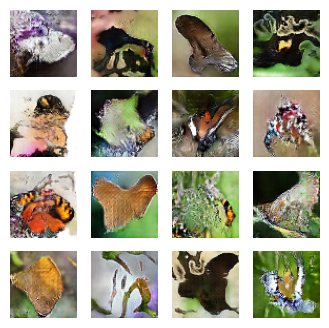

425/425 [==============================] - 31s 73ms/step - d_loss: 0.4441 - g_loss: 1.7455
Epoch 75/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4475 - g_loss: 1.7383

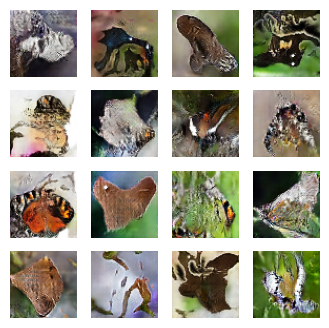

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4475 - g_loss: 1.7383
Epoch 76/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4331 - g_loss: 1.7609

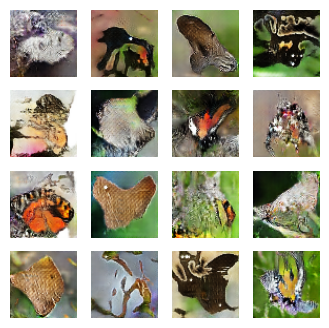

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4331 - g_loss: 1.7609
Epoch 77/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4358 - g_loss: 1.7661

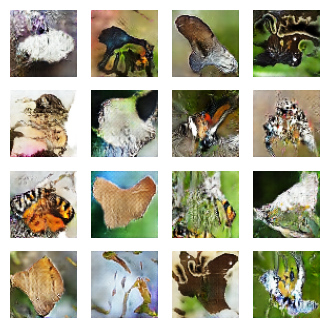

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4358 - g_loss: 1.7661
Epoch 78/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4295 - g_loss: 1.8177

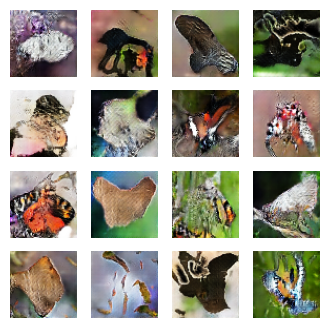

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4295 - g_loss: 1.8177
Epoch 79/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4416 - g_loss: 1.8413

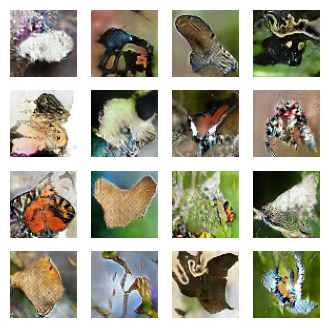

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4416 - g_loss: 1.8413
Epoch 80/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4345 - g_loss: 1.8183

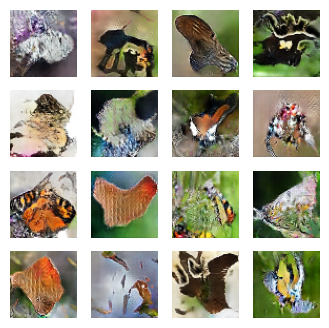

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4345 - g_loss: 1.8183
Epoch 81/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4244 - g_loss: 1.8449

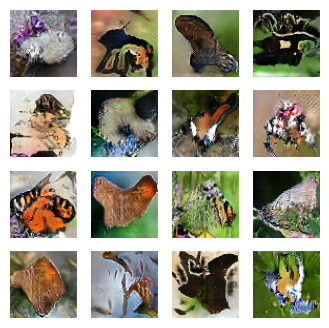

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4244 - g_loss: 1.8449
Epoch 82/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4232 - g_loss: 1.8281

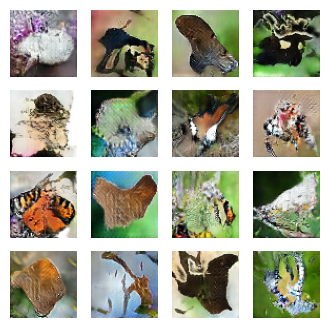

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4232 - g_loss: 1.8281
Epoch 83/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4255 - g_loss: 1.8779

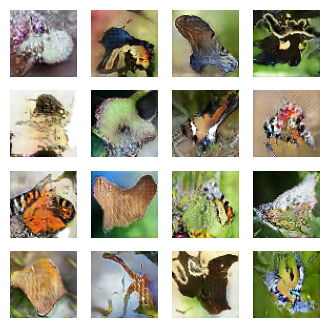

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4255 - g_loss: 1.8779
Epoch 84/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4100 - g_loss: 1.8929

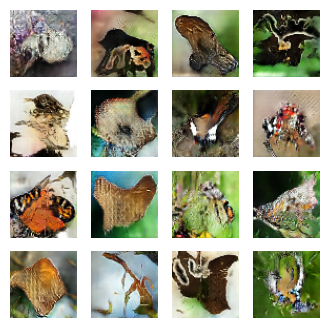

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4100 - g_loss: 1.8929
Epoch 85/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4154 - g_loss: 1.9125

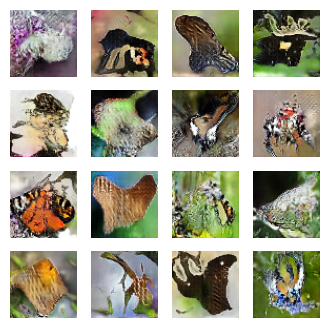

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4154 - g_loss: 1.9125
Epoch 86/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4146 - g_loss: 1.9270

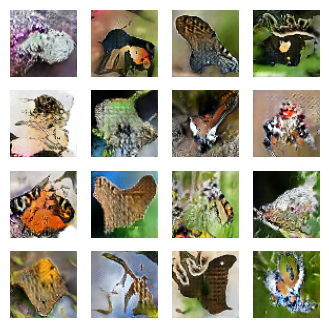

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4146 - g_loss: 1.9270
Epoch 87/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4140 - g_loss: 1.9425

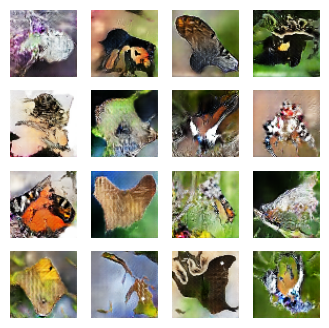

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4140 - g_loss: 1.9425
Epoch 88/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4043 - g_loss: 1.9685

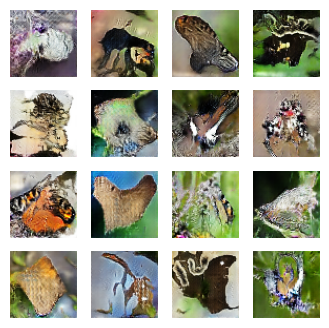

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4043 - g_loss: 1.9685
Epoch 89/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4044 - g_loss: 1.9679

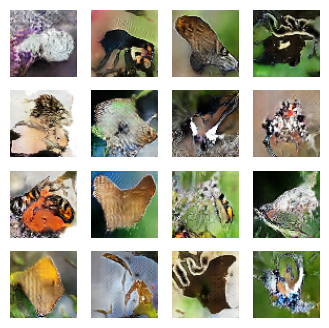

425/425 [==============================] - 31s 73ms/step - d_loss: 0.4044 - g_loss: 1.9679
Epoch 90/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4028 - g_loss: 1.9663

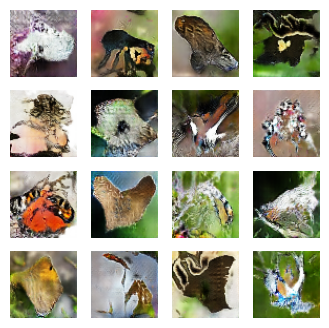

425/425 [==============================] - 32s 75ms/step - d_loss: 0.4028 - g_loss: 1.9663
Epoch 91/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4041 - g_loss: 1.9775

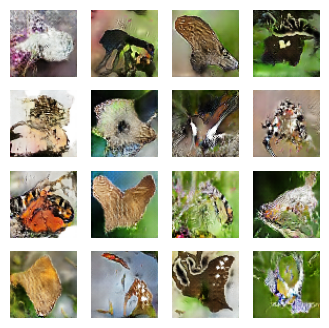

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4041 - g_loss: 1.9775
Epoch 92/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3968 - g_loss: 1.9838

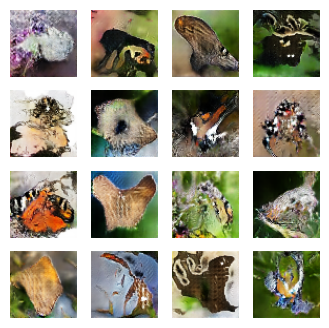

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3968 - g_loss: 1.9838
Epoch 93/120
425/425 [==============================] - ETA: 0s - d_loss: 0.4021 - g_loss: 1.9991

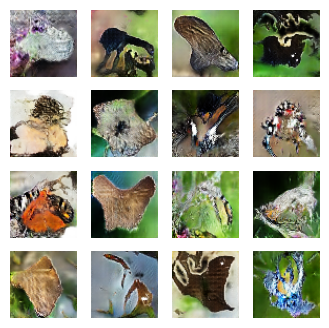

425/425 [==============================] - 32s 74ms/step - d_loss: 0.4021 - g_loss: 1.9991
Epoch 94/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3987 - g_loss: 2.0275

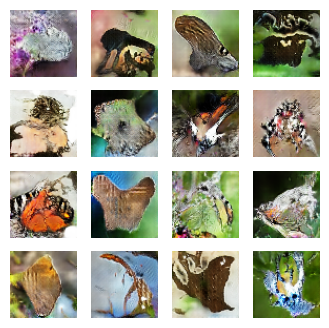

425/425 [==============================] - 32s 75ms/step - d_loss: 0.3987 - g_loss: 2.0275
Epoch 95/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3897 - g_loss: 2.0367

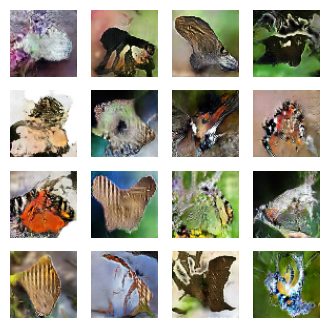

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3897 - g_loss: 2.0367
Epoch 96/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3895 - g_loss: 2.0545

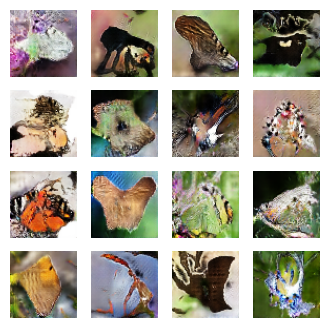

425/425 [==============================] - 31s 74ms/step - d_loss: 0.3895 - g_loss: 2.0545
Epoch 97/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3886 - g_loss: 2.0628

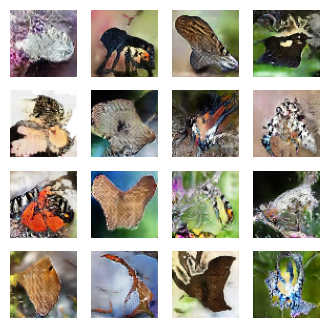

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3886 - g_loss: 2.0628
Epoch 98/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3799 - g_loss: 2.0828

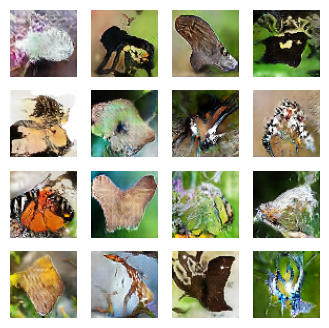

425/425 [==============================] - 32s 75ms/step - d_loss: 0.3799 - g_loss: 2.0828
Epoch 99/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3783 - g_loss: 2.1041

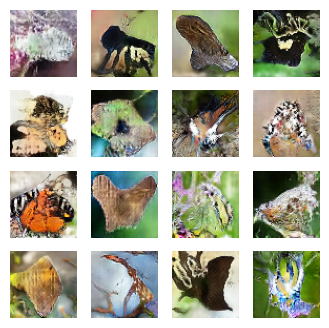

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3783 - g_loss: 2.1041
Epoch 100/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3792 - g_loss: 2.1351

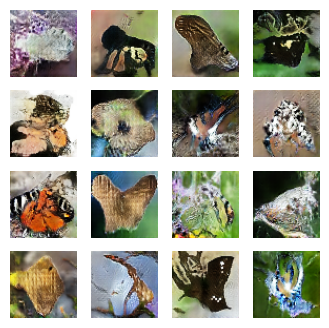

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3792 - g_loss: 2.1351
Epoch 101/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3945 - g_loss: 2.1350

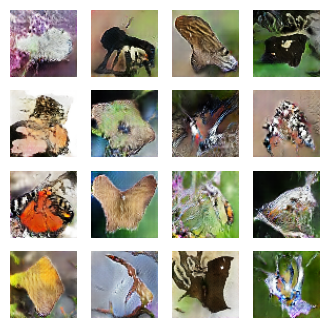

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3945 - g_loss: 2.1350
Epoch 102/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3787 - g_loss: 2.1259

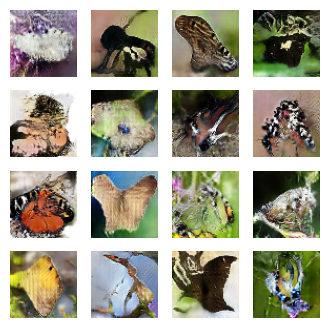

425/425 [==============================] - 33s 76ms/step - d_loss: 0.3787 - g_loss: 2.1259
Epoch 103/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3677 - g_loss: 2.1673

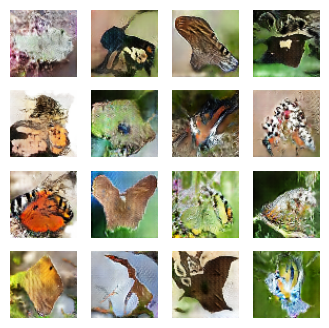

425/425 [==============================] - 32s 76ms/step - d_loss: 0.3677 - g_loss: 2.1673
Epoch 104/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3714 - g_loss: 2.1767

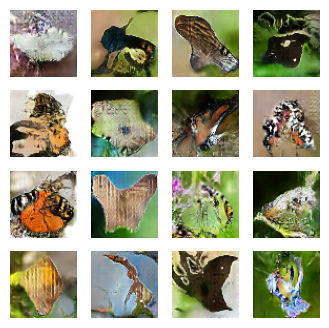

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3714 - g_loss: 2.1767
Epoch 105/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3763 - g_loss: 2.2075

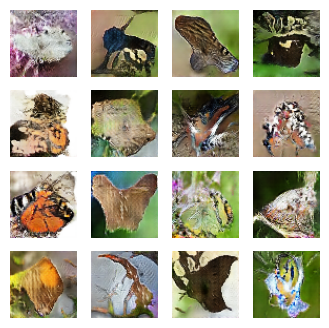

425/425 [==============================] - 32s 75ms/step - d_loss: 0.3763 - g_loss: 2.2075
Epoch 106/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3663 - g_loss: 2.2017

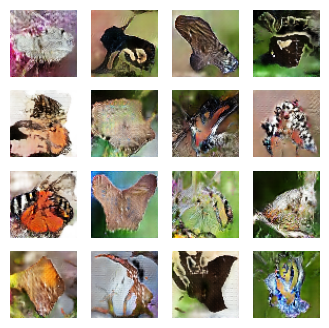

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3663 - g_loss: 2.2017
Epoch 107/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3687 - g_loss: 2.1959

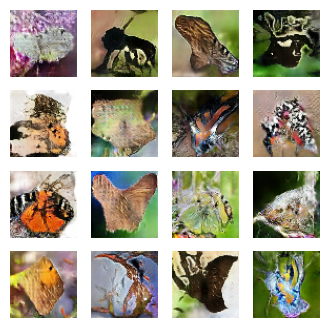

425/425 [==============================] - 32s 75ms/step - d_loss: 0.3687 - g_loss: 2.1959
Epoch 108/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3642 - g_loss: 2.2358

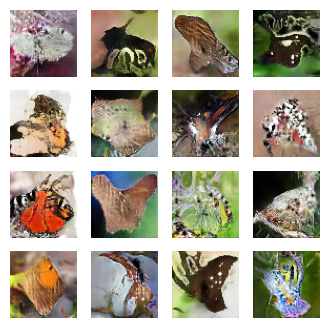

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3642 - g_loss: 2.2358
Epoch 109/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3585 - g_loss: 2.2677

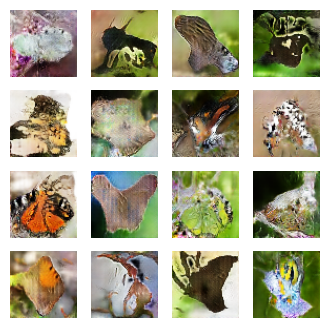

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3585 - g_loss: 2.2677
Epoch 110/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3635 - g_loss: 2.2674

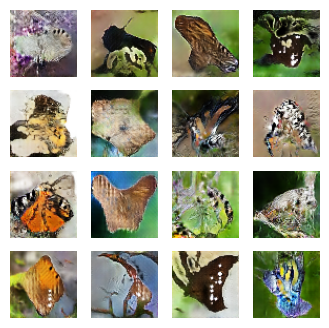

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3635 - g_loss: 2.2674
Epoch 111/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3627 - g_loss: 2.2531

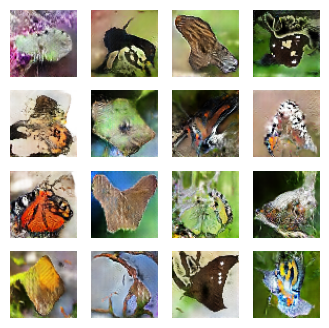

425/425 [==============================] - 32s 75ms/step - d_loss: 0.3627 - g_loss: 2.2531
Epoch 112/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3594 - g_loss: 2.2760

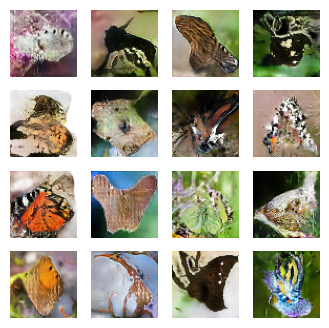

425/425 [==============================] - 32s 75ms/step - d_loss: 0.3594 - g_loss: 2.2760
Epoch 113/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3580 - g_loss: 2.2985

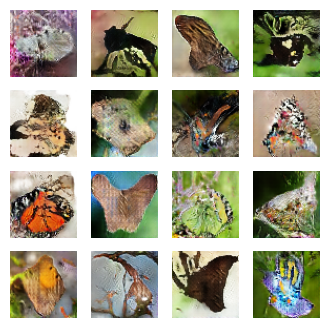

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3580 - g_loss: 2.2985
Epoch 114/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3445 - g_loss: 2.3067

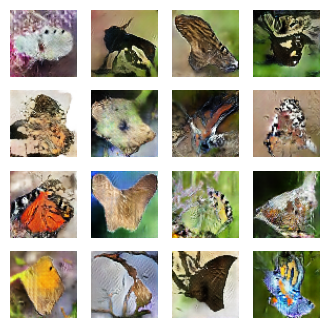

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3445 - g_loss: 2.3067
Epoch 115/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3557 - g_loss: 2.3341

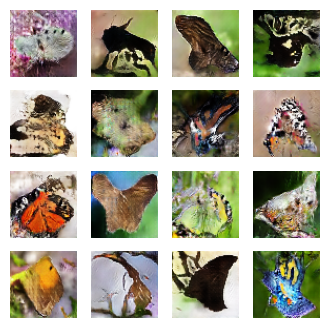

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3557 - g_loss: 2.3341
Epoch 116/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3435 - g_loss: 2.3360

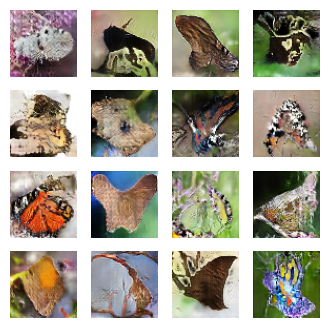

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3435 - g_loss: 2.3360
Epoch 117/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3570 - g_loss: 2.3648

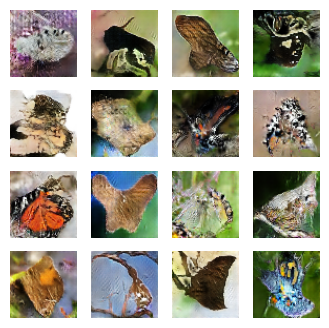

425/425 [==============================] - 32s 73ms/step - d_loss: 0.3570 - g_loss: 2.3648
Epoch 118/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3381 - g_loss: 2.3708

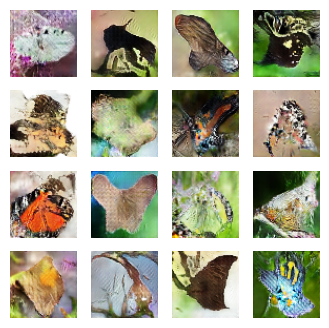

425/425 [==============================] - 31s 73ms/step - d_loss: 0.3381 - g_loss: 2.3708
Epoch 119/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3484 - g_loss: 2.3815

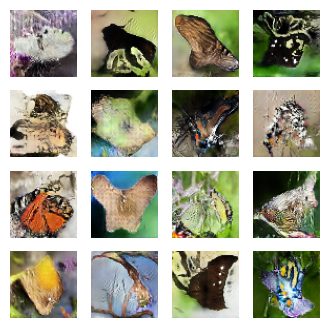

425/425 [==============================] - 32s 74ms/step - d_loss: 0.3484 - g_loss: 2.3815
Epoch 120/120
425/425 [==============================] - ETA: 0s - d_loss: 0.3411 - g_loss: 2.4188

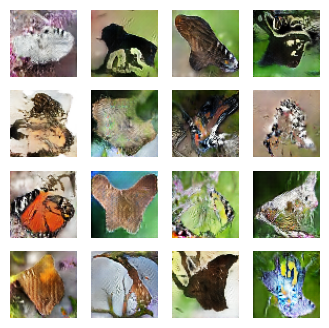

425/425 [==============================] - 32s 75ms/step - d_loss: 0.3411 - g_loss: 2.4188


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
dcgan = DCGAN(discriminator=discriminator, generator=generator, latent_dim=LATENT_DIM)
dcgan.compile(
    d_optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1 = 0.5),
    g_optimizer=tf.keras.optimizers.Adam(learning_rate=0.0003, beta_1 = 0.5),
    loss_fn=tf.keras.losses.BinaryCrossentropy(),)
dcgan.fit(dataset, epochs=120, callbacks=[GANMonitor(num_img=16, latent_dim=LATENT_DIM)])